## Copyright 2023 Google LLC

In [1]:
# Copyright 2023 Google LLC
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#      http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# ControlNet depth with StyleAligned over Animagine XL 3.1

In [2]:
from diffusers import ControlNetModel, StableDiffusionXLControlNetPipeline, AutoencoderKL
from diffusers.utils import load_image
from transformers import DPTImageProcessor, DPTForDepthEstimation
import torch
import mediapy
import sa_handler
import pipeline_calls

/usr/local/lib/python3.10/dist-packages/diffusers/utils/outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
/usr/local/lib/python3.10/dist-packages/diffusers/utils/outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
/usr/local/lib/python3.10/dist-packages/diffusers/utils/outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
/usr/local/lib/python3.10/dist-packages/diffusers/utils/outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(


In [3]:
# init models

depth_estimator = DPTForDepthEstimation.from_pretrained("Intel/dpt-hybrid-midas").to("cuda")
feature_processor = DPTImageProcessor.from_pretrained("Intel/dpt-hybrid-midas")

controlnet = ControlNetModel.from_pretrained(
    "diffusers/controlnet-depth-sdxl-1.0",
    variant="fp16",
    use_safetensors=True,
    torch_dtype=torch.float16,
).to("cuda")
vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16).to("cuda")
pipeline = StableDiffusionXLControlNetPipeline.from_pretrained(
    "cagliostrolab/animagine-xl-3.1",
    controlnet=controlnet,
    vae=vae,
    use_safetensors=True,
    torch_dtype=torch.float16,
).to("cuda")
pipeline.enable_model_cpu_offload()
pipeline.enable_vae_slicing()
pipeline.enable_vae_tiling()

sa_args = sa_handler.StyleAlignedArgs(share_group_norm=False,
                                      share_layer_norm=False,
                                      share_attention=True,
                                      adain_queries=True,
                                      adain_keys=True,
                                      adain_values=False,
                                     )
handler = sa_handler.Handler(pipeline)
handler.register(sa_args, )

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

,

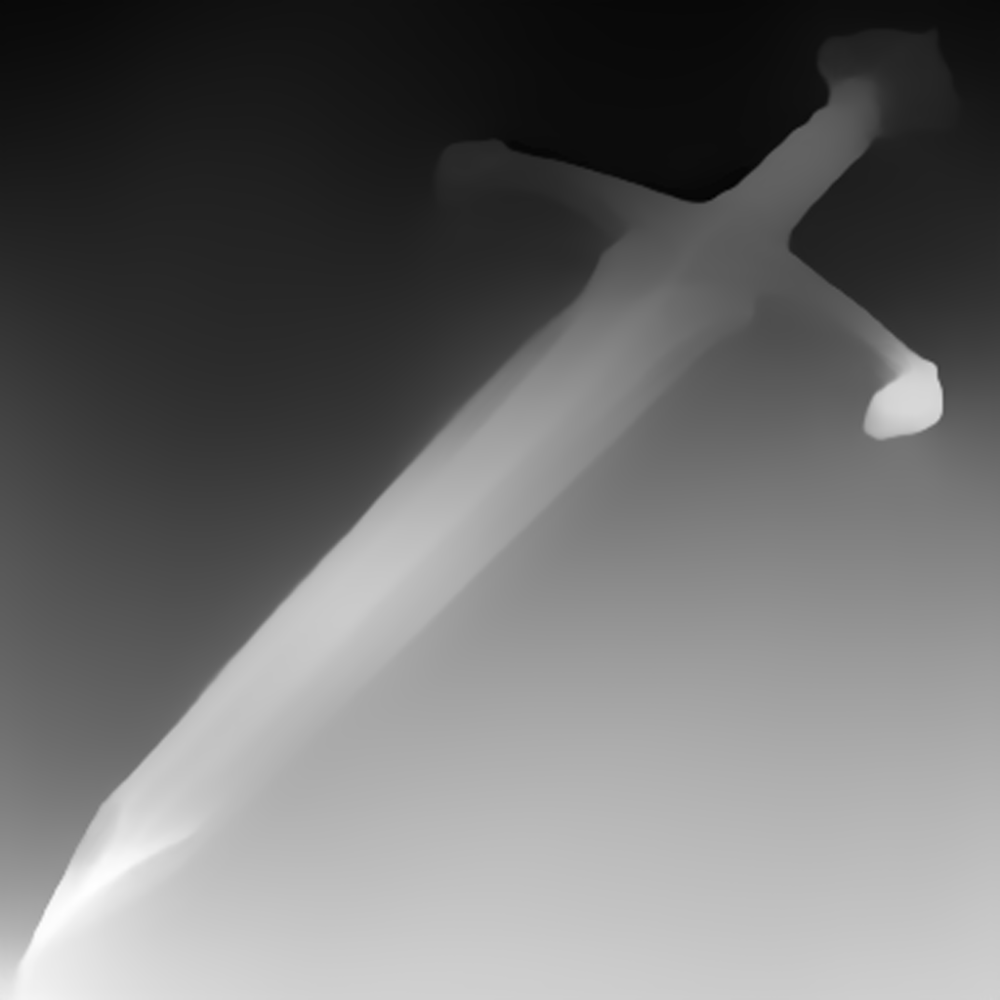
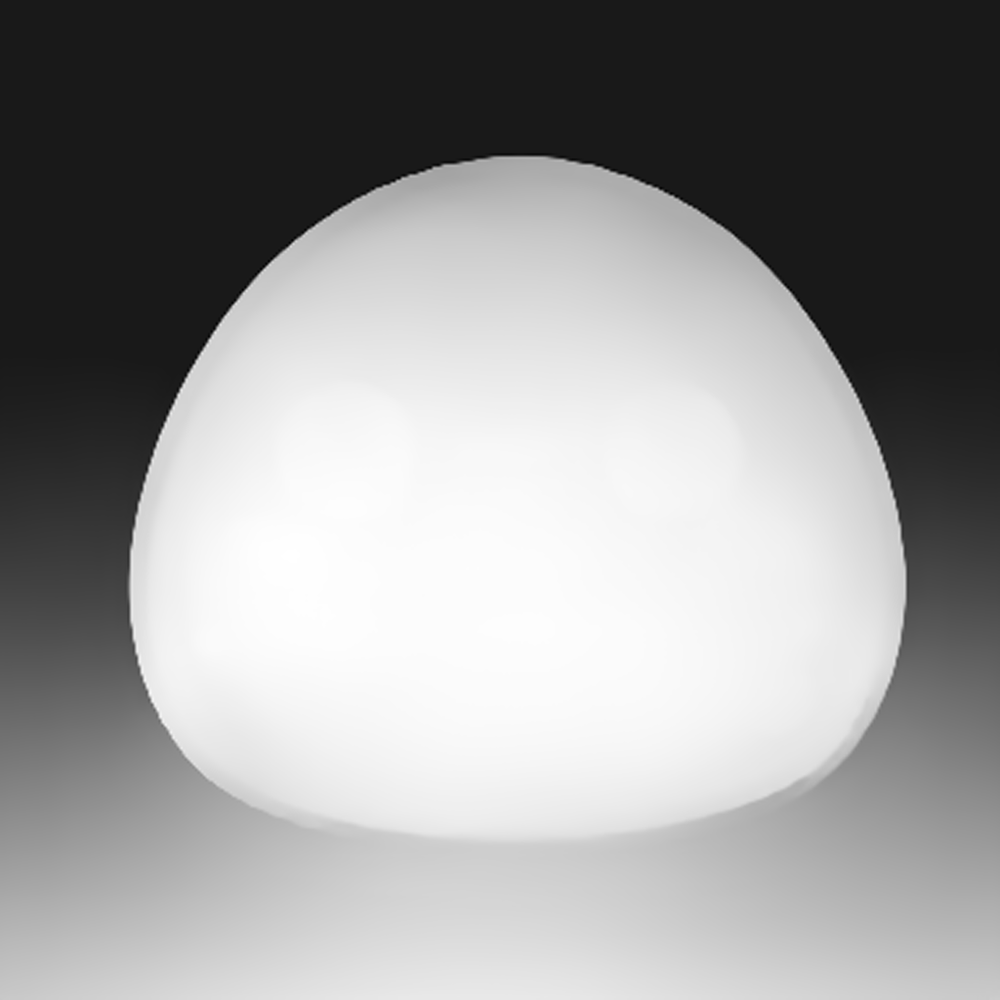

In [4]:
# get depth maps
image = load_image("./sword.png")
depth_image1 = pipeline_calls.get_depth_map(image, feature_processor, depth_estimator)
image = load_image("./slime.png")
depth_image2 = pipeline_calls.get_depth_map(image, feature_processor, depth_estimator)
mediapy.show_images([depth_image1, depth_image2])

  0%|          | 0/50 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/diffusers/models/lora.py:358: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


reference,depth,result 1,result 2,result 3

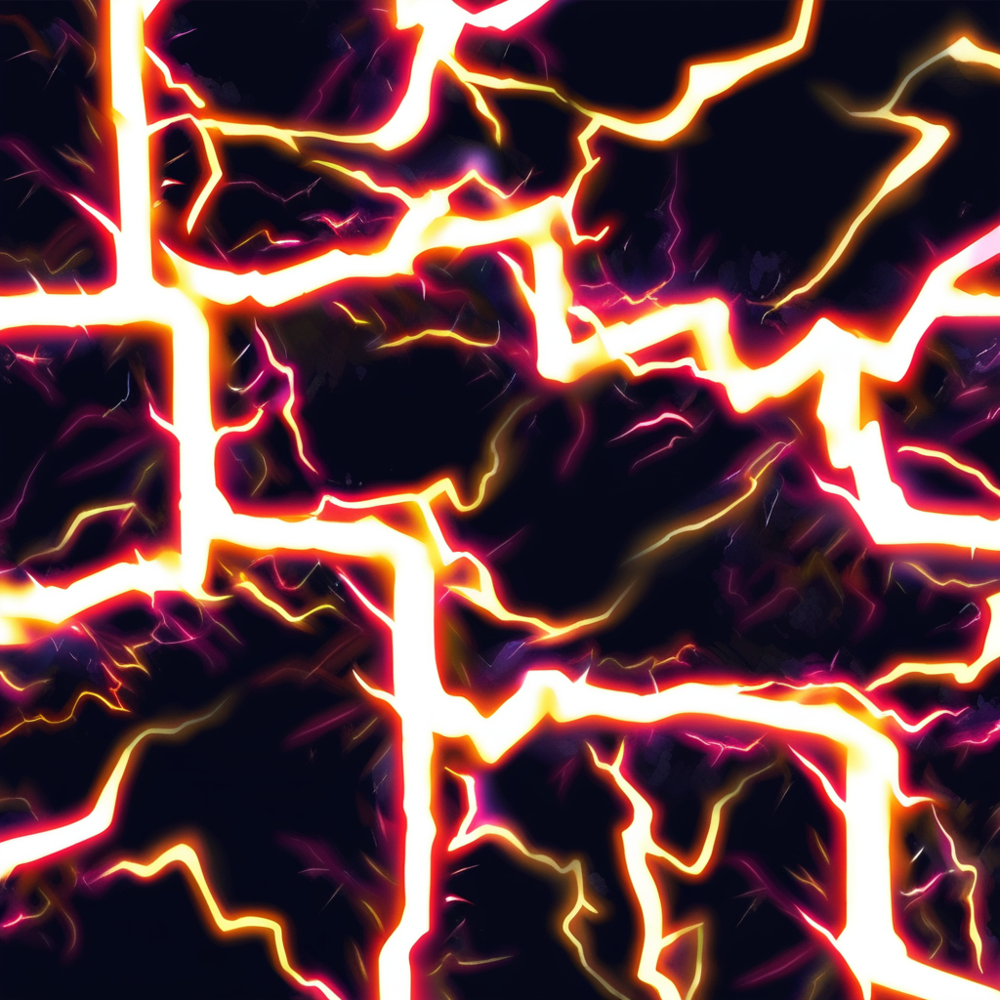
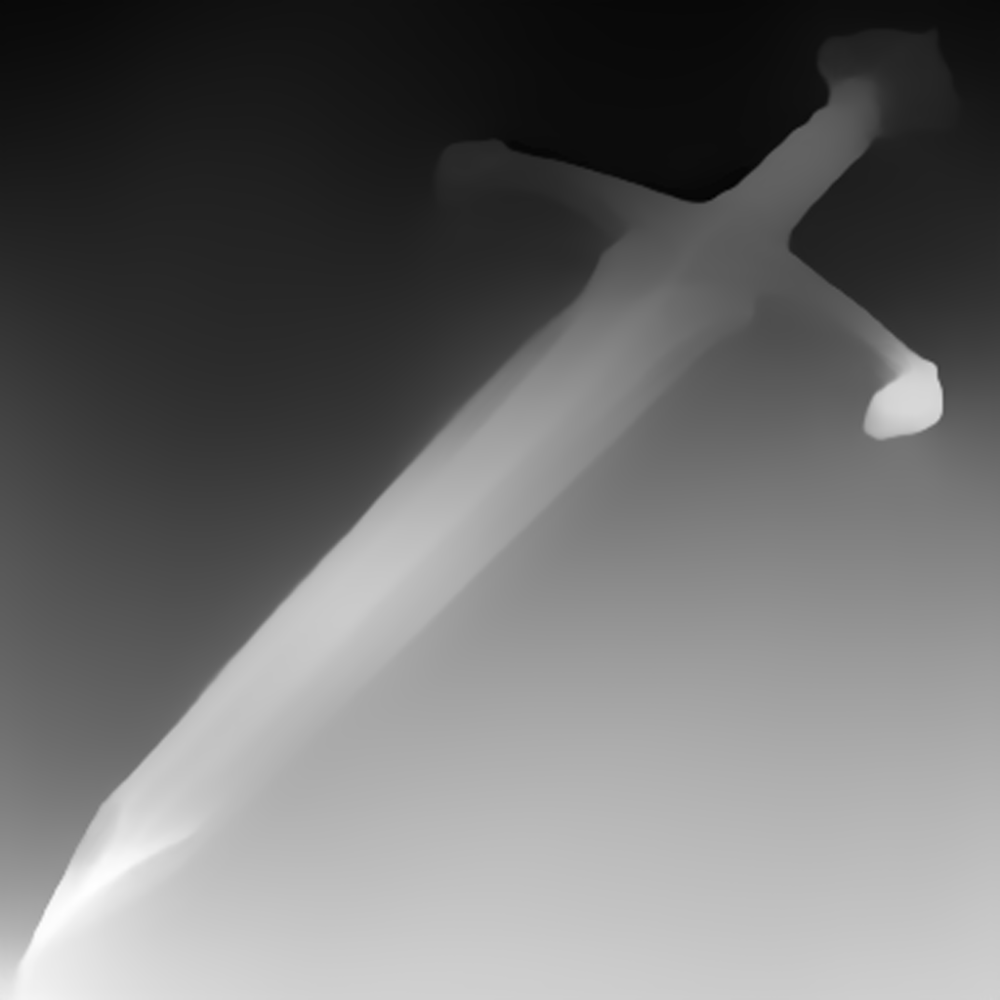
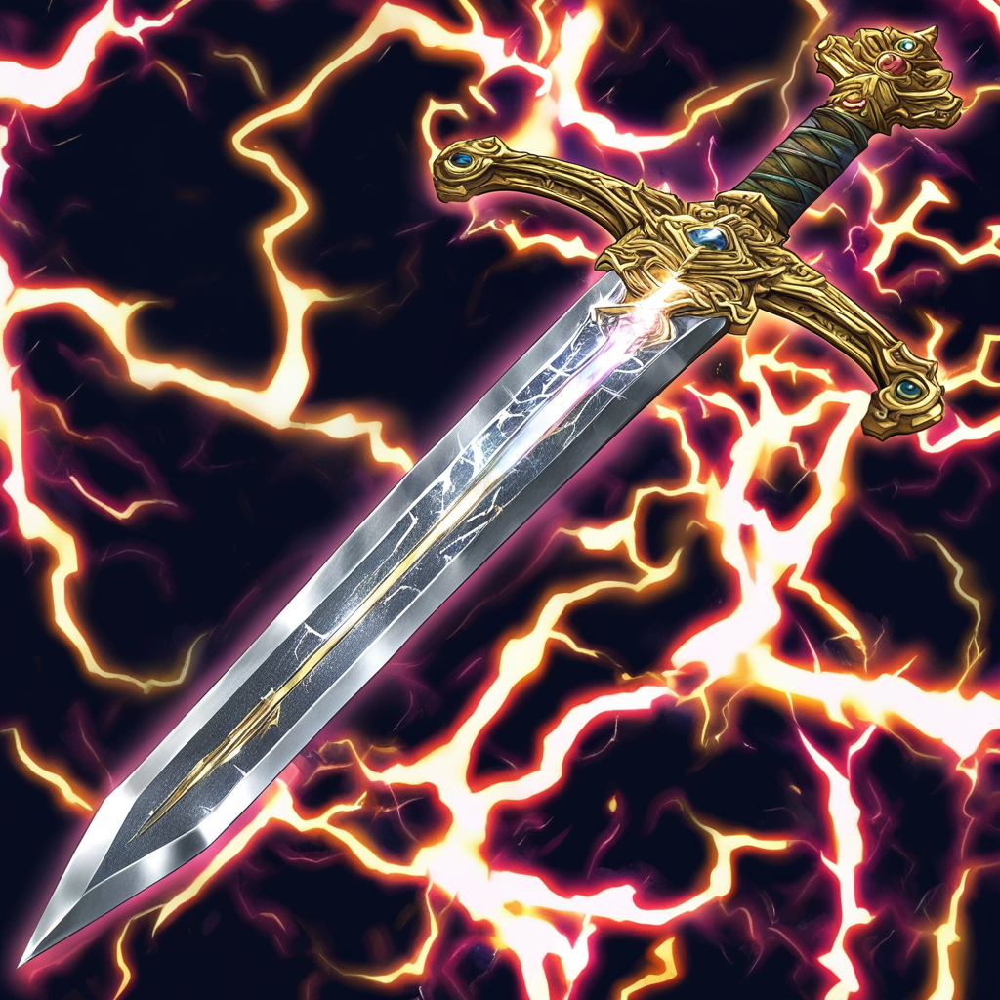
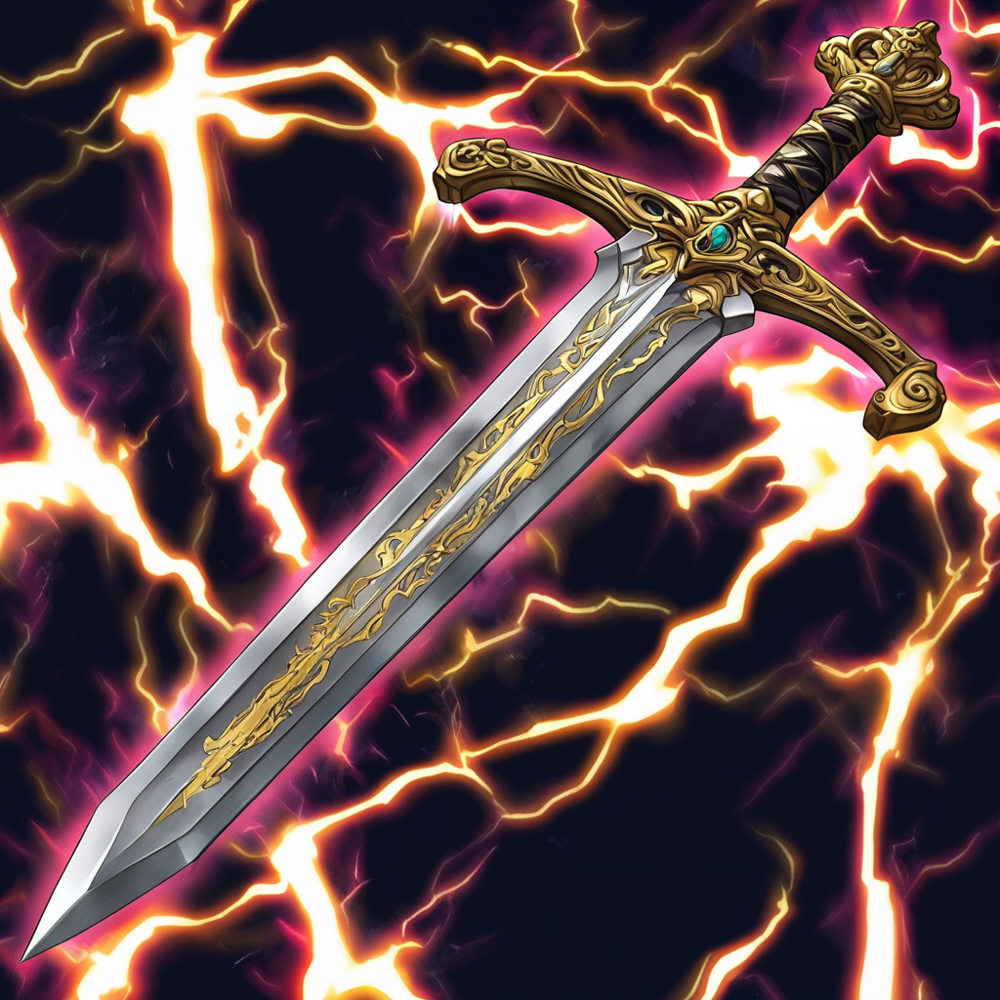
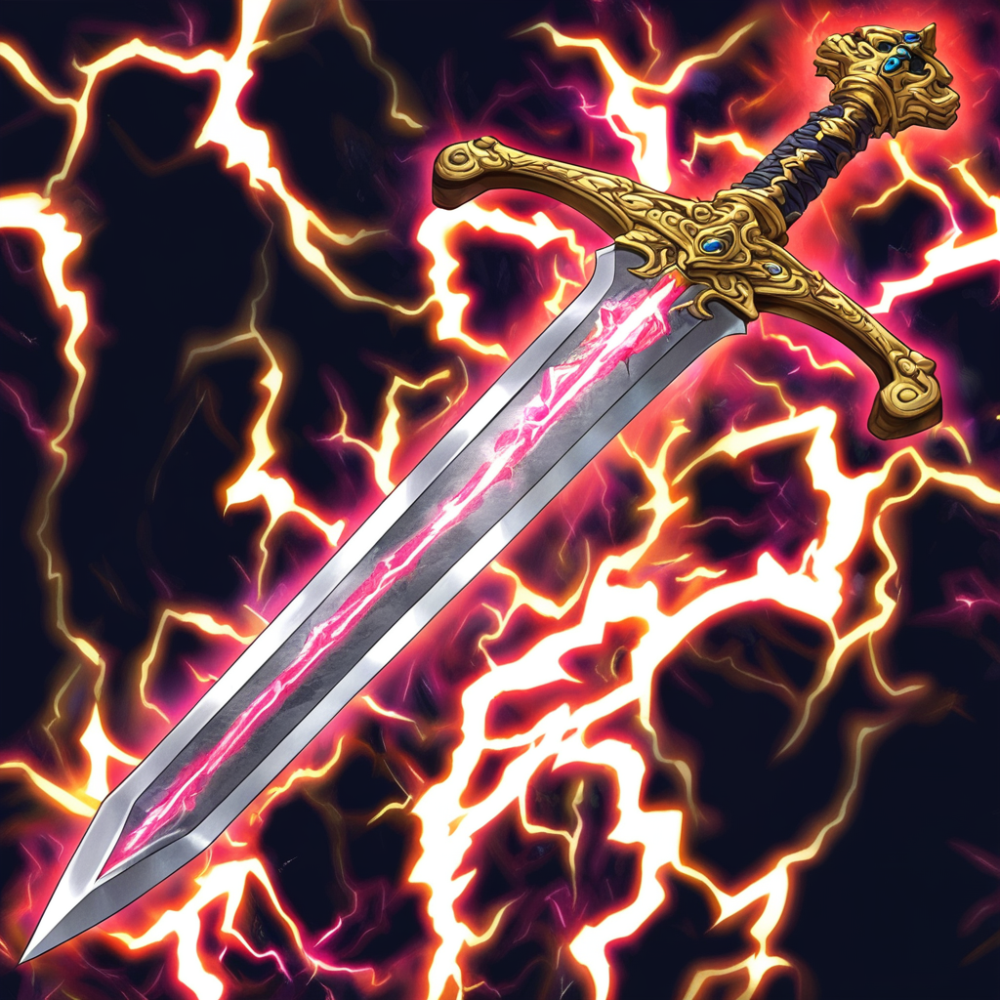

  0%|          | 0/50 [00:00<?, ?it/s]

reference,depth,result 1,result 2,result 3

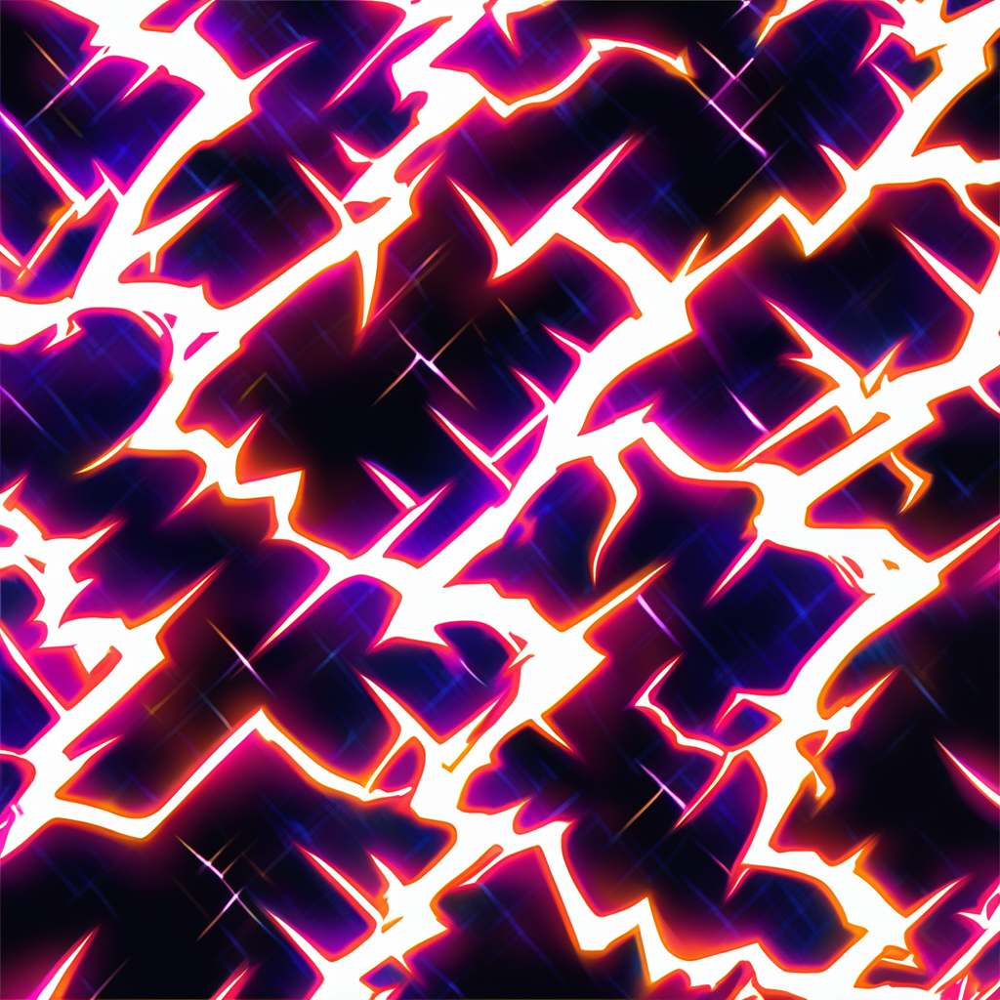
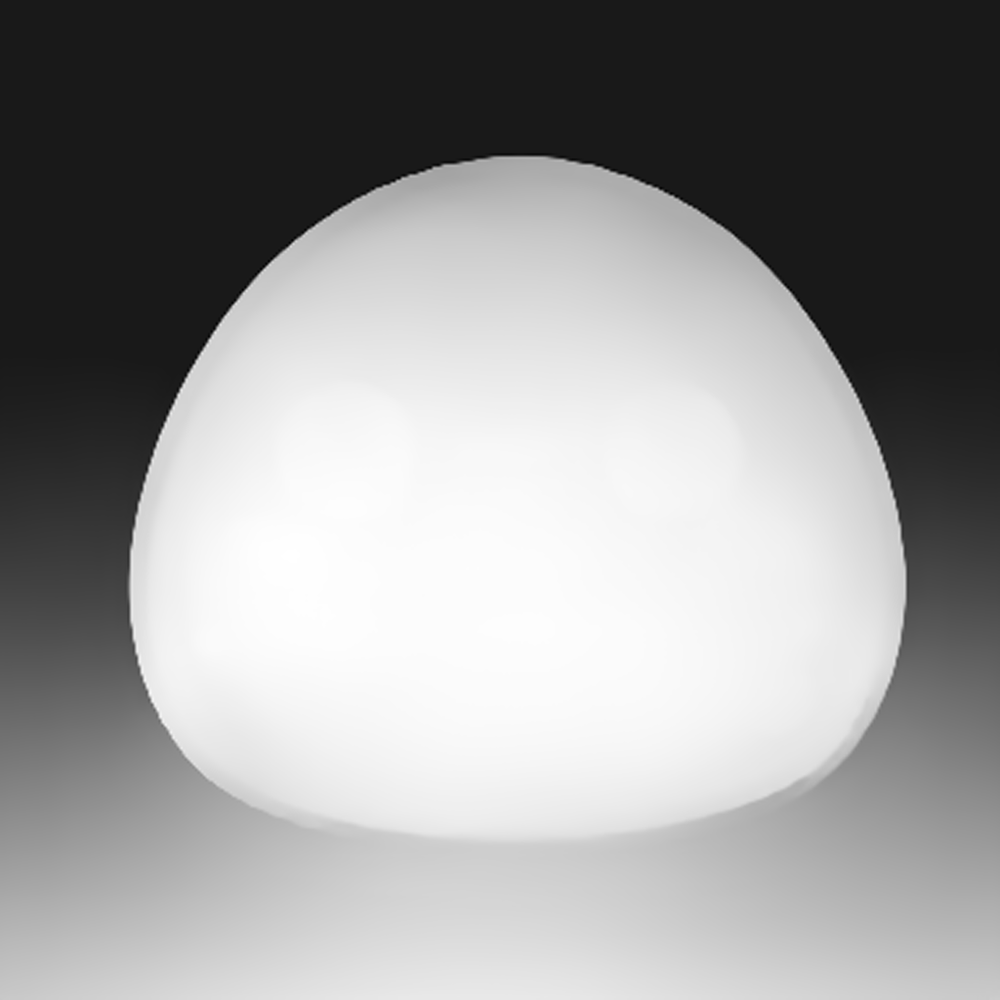
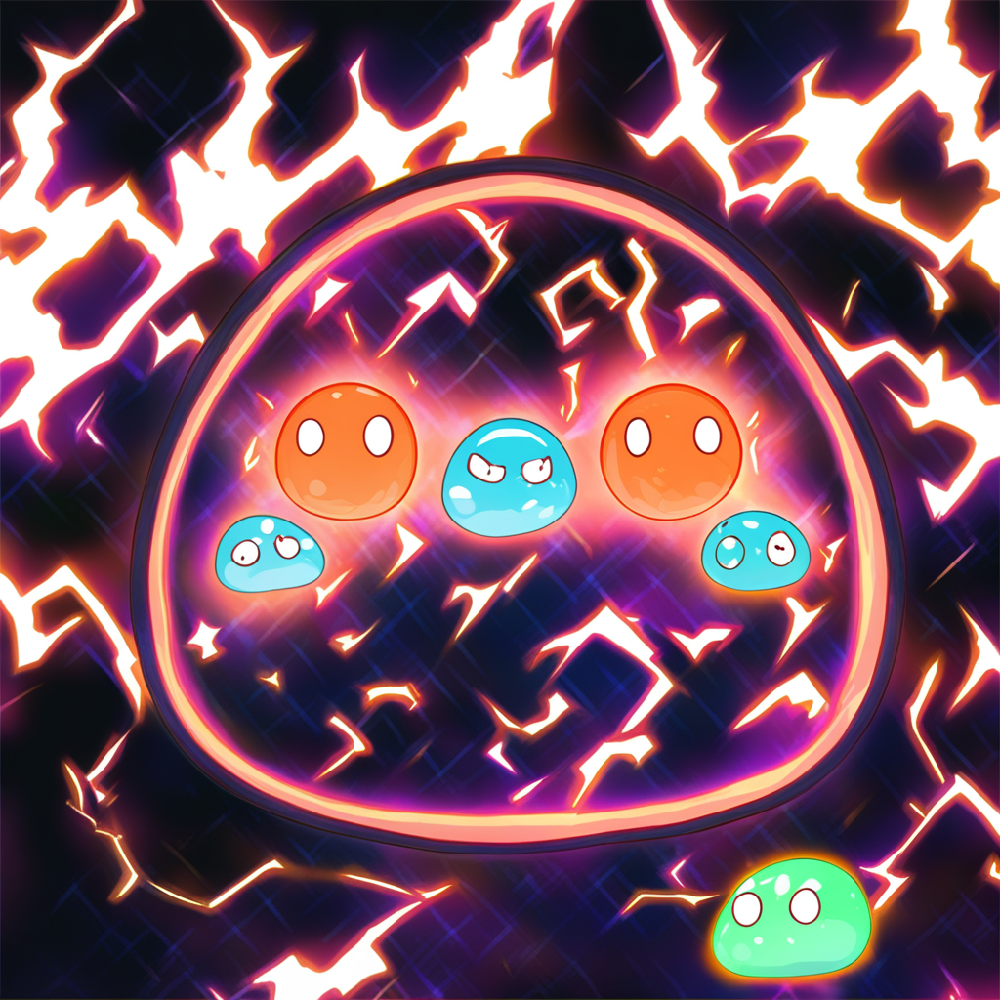
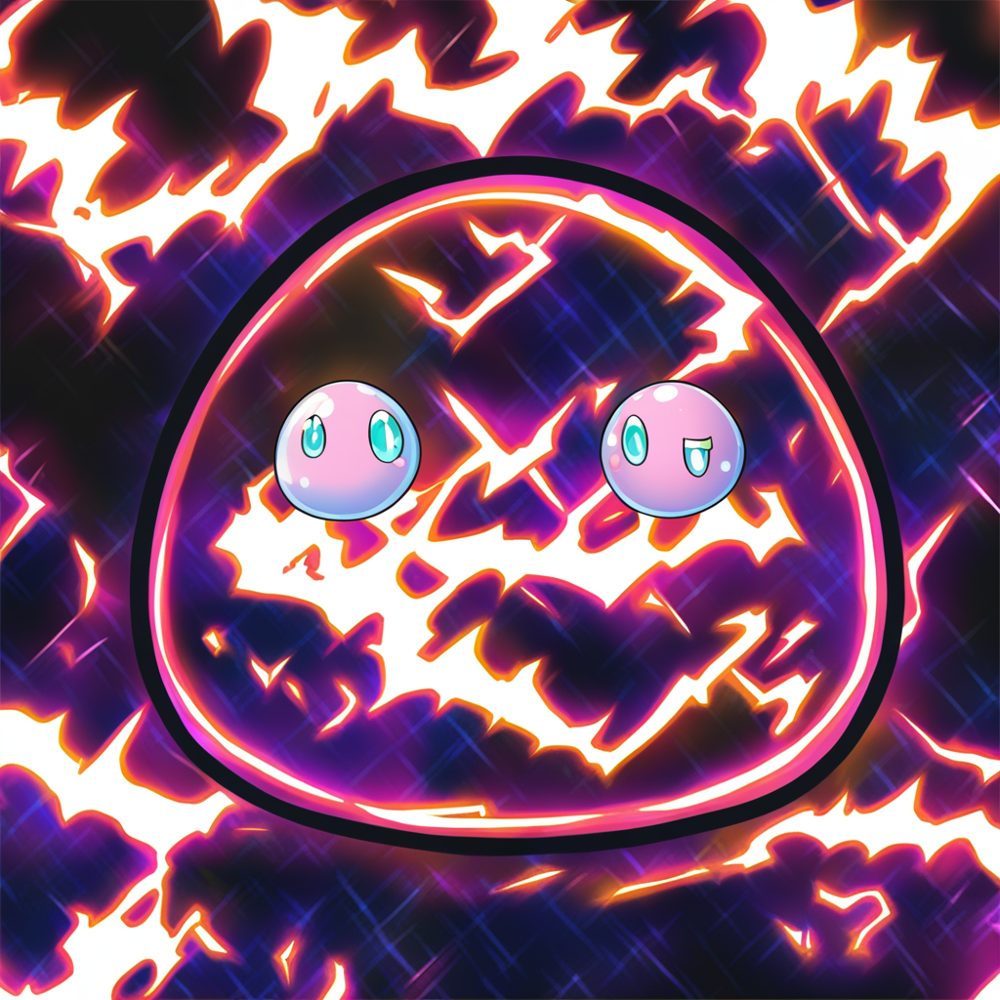
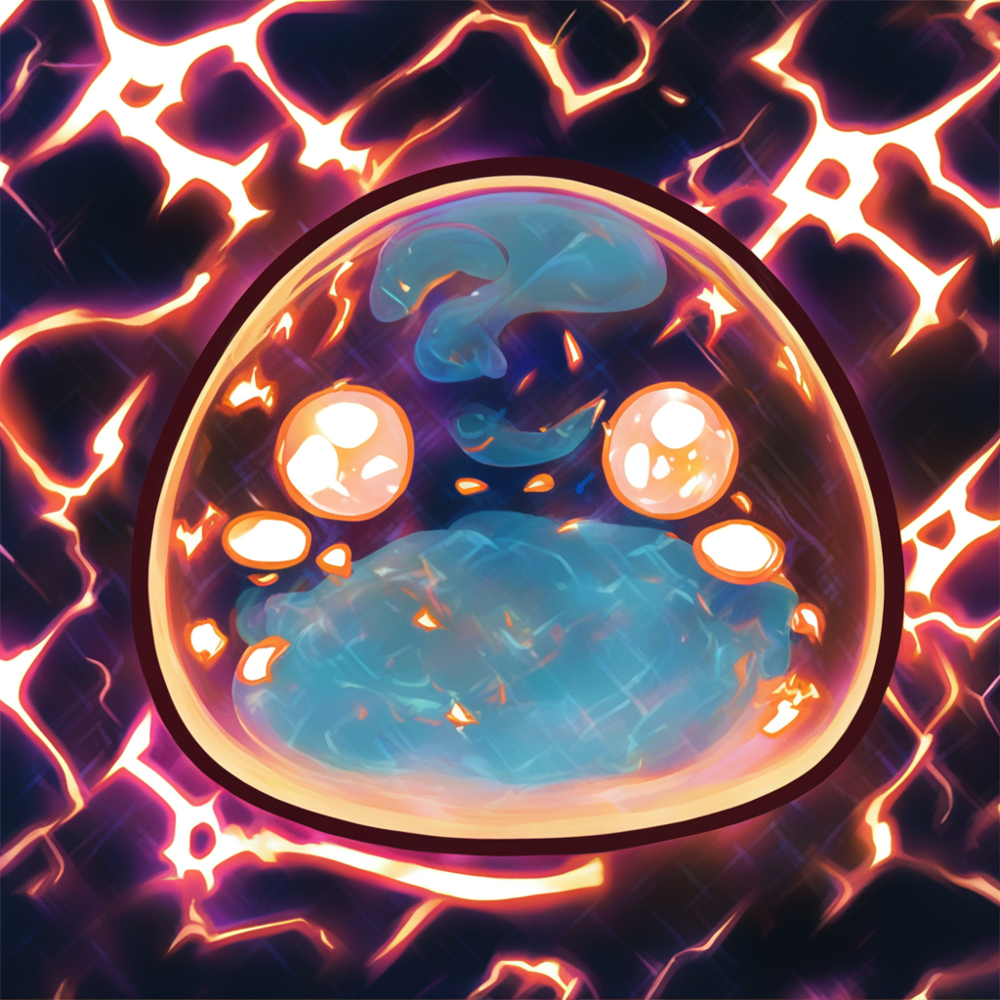

In [5]:
# run ControlNet depth with StyleAligned

reference_prompt = "effect with lightning pattern"
target_prompts = ["a sword of effect with lightning pattern", "a slime of effect with lightning pattern"]
controlnet_conditioning_scale = 0.8
num_images_per_prompt = 3 # adjust according to VRAM size
latents = torch.randn(1 + num_images_per_prompt, 4, 128, 128).to(pipeline.unet.dtype)

for deph_map, target_prompt in zip((depth_image1, depth_image2), target_prompts):
    latents[1:] = torch.randn(num_images_per_prompt, 4, 128, 128).to(pipeline.unet.dtype)
    images = pipeline_calls.controlnet_call(pipeline, [reference_prompt, target_prompt],
                                            image=deph_map,
                                            num_inference_steps=50,
                                            controlnet_conditioning_scale=controlnet_conditioning_scale,
                                            num_images_per_prompt=num_images_per_prompt,
                                           latents=latents)
    
    mediapy.show_images([images[0], deph_map] +  images[1:], titles=["reference", "depth"] + [f'result {i}' for i in range(1, len(images))])


  0%|          | 0/50 [00:00<?, ?it/s]

reference,depth,result 1,result 2,result 3

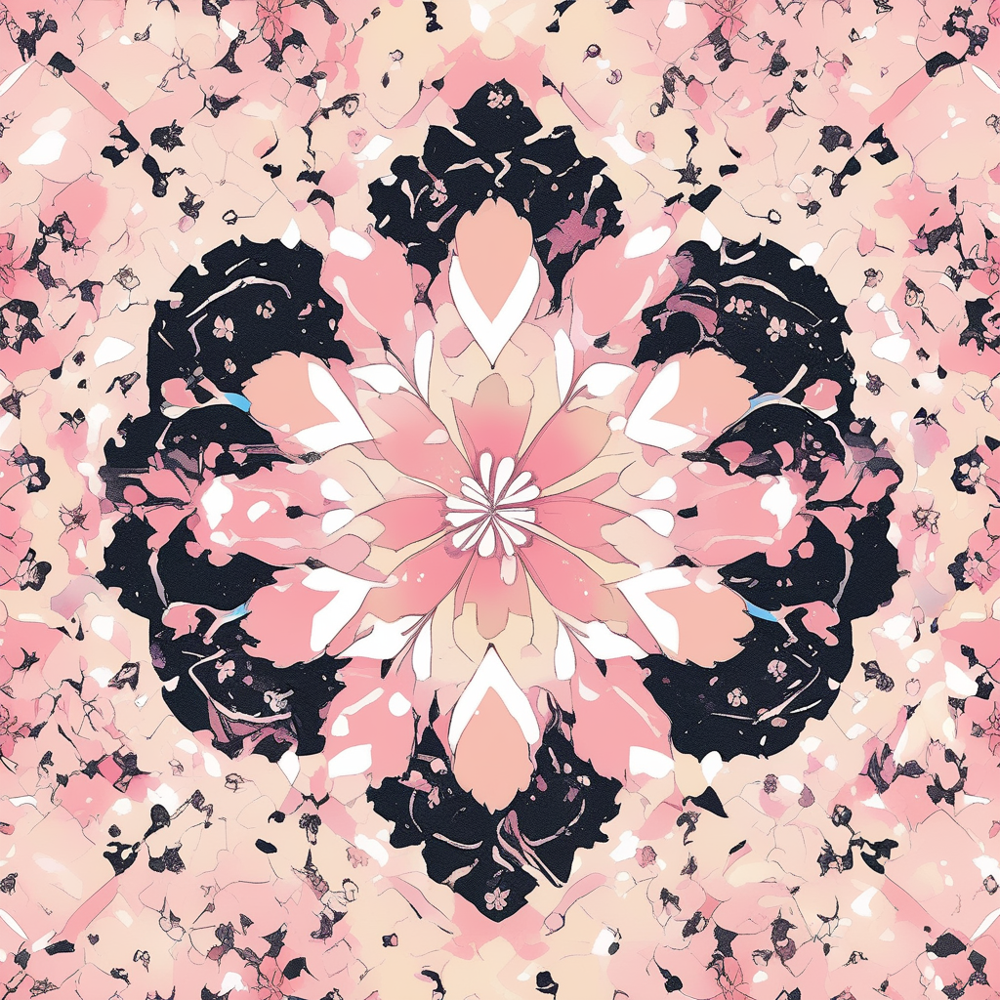
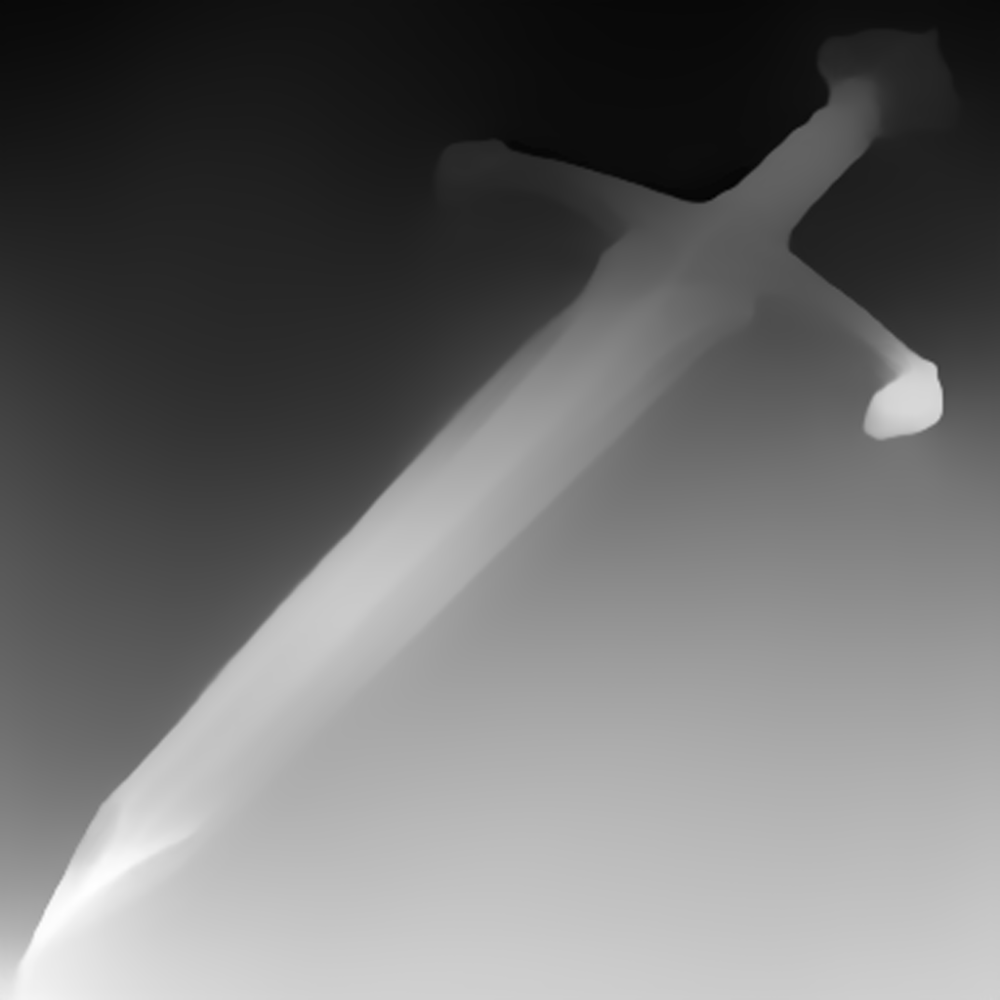
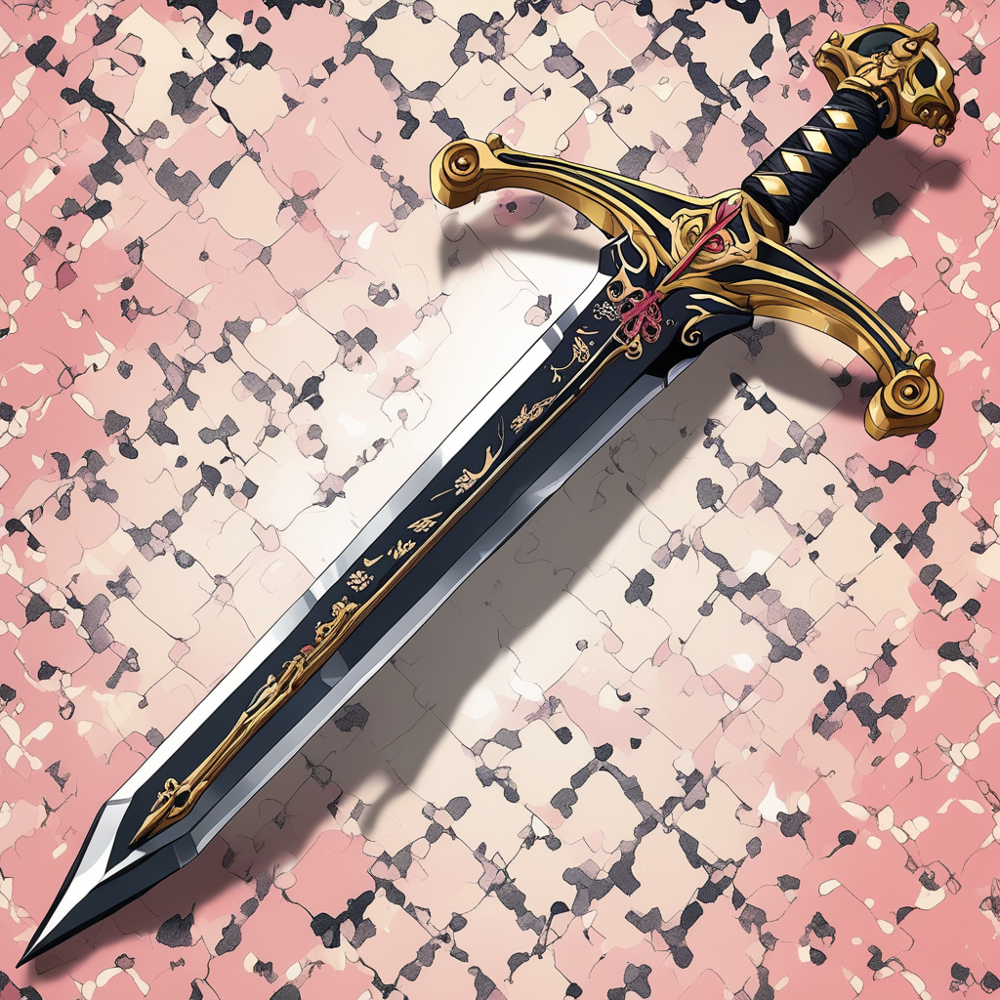
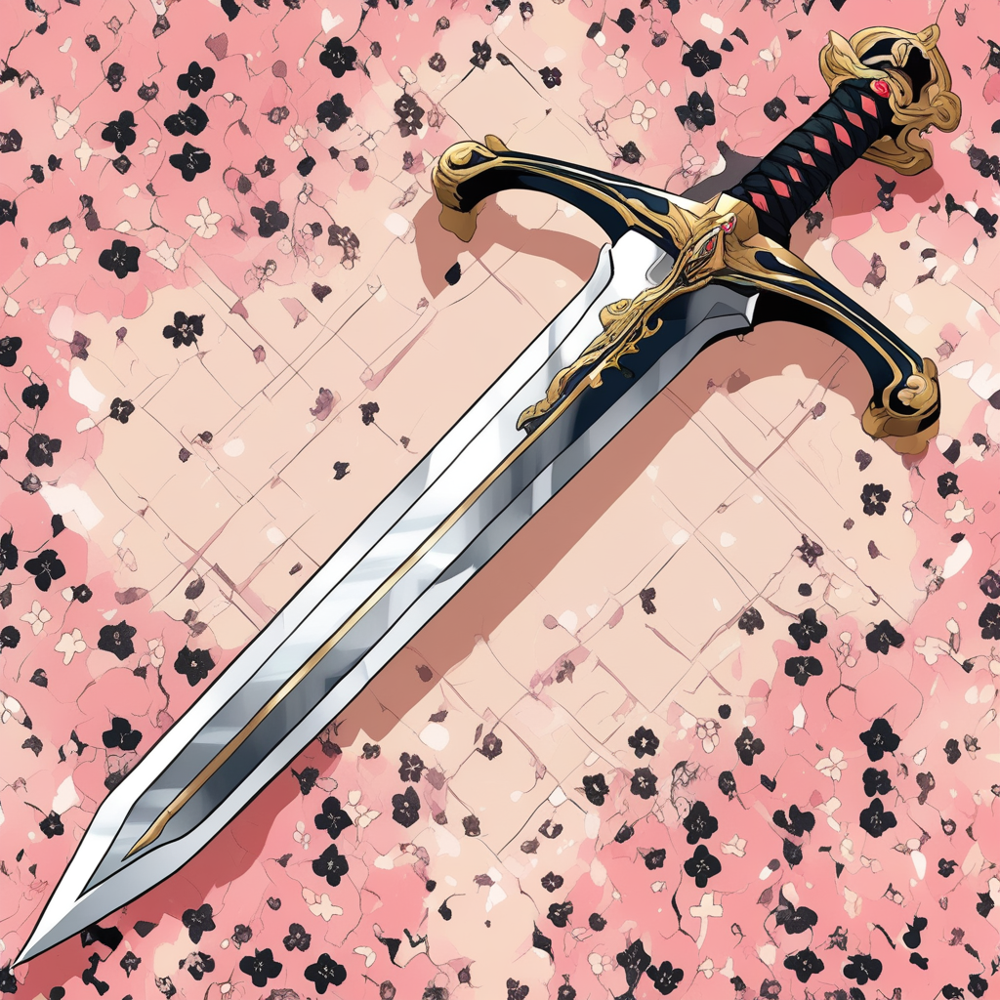
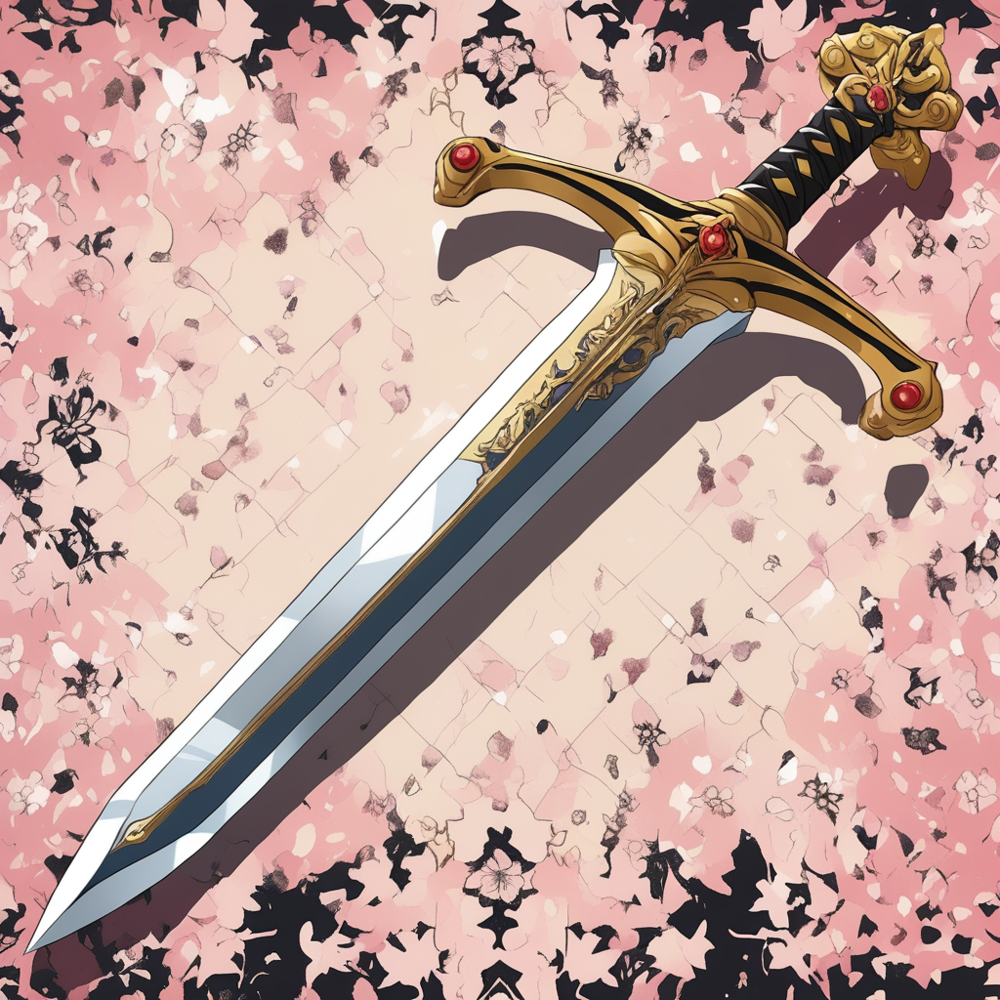

  0%|          | 0/50 [00:00<?, ?it/s]

reference,depth,result 1,result 2,result 3

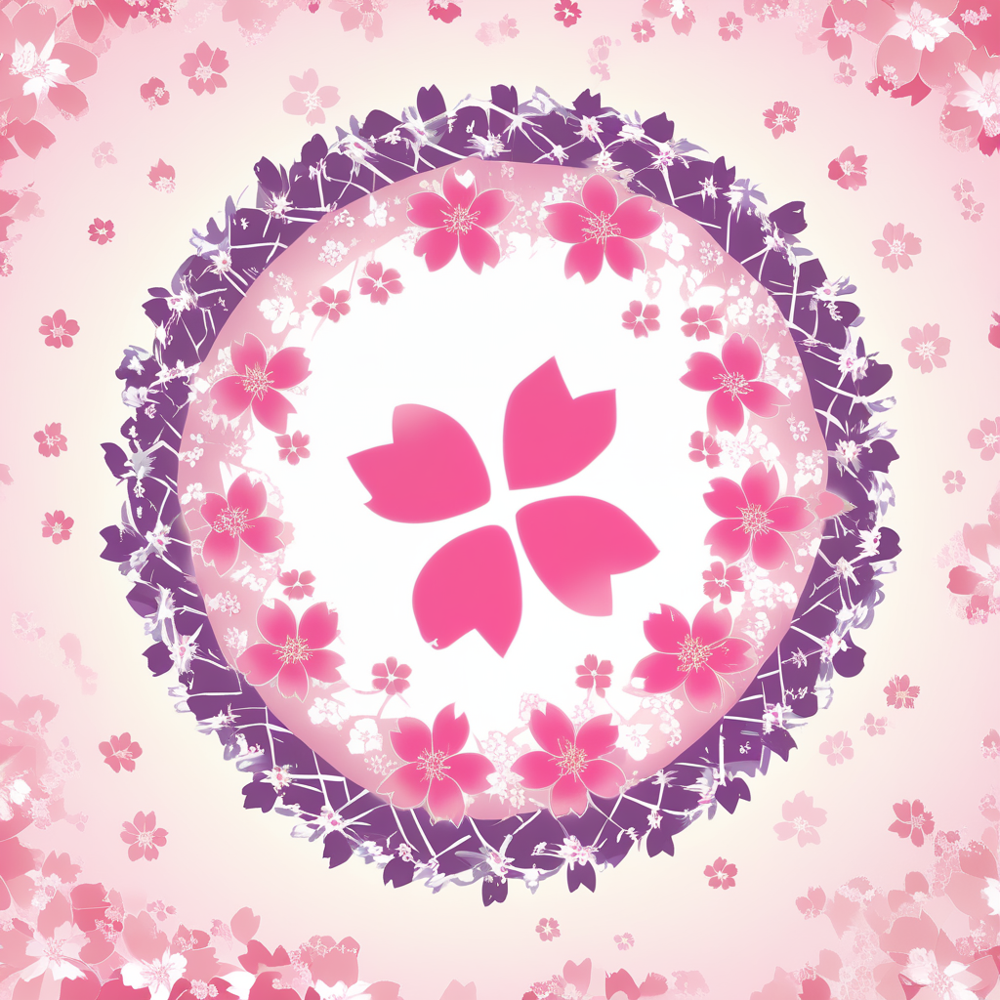
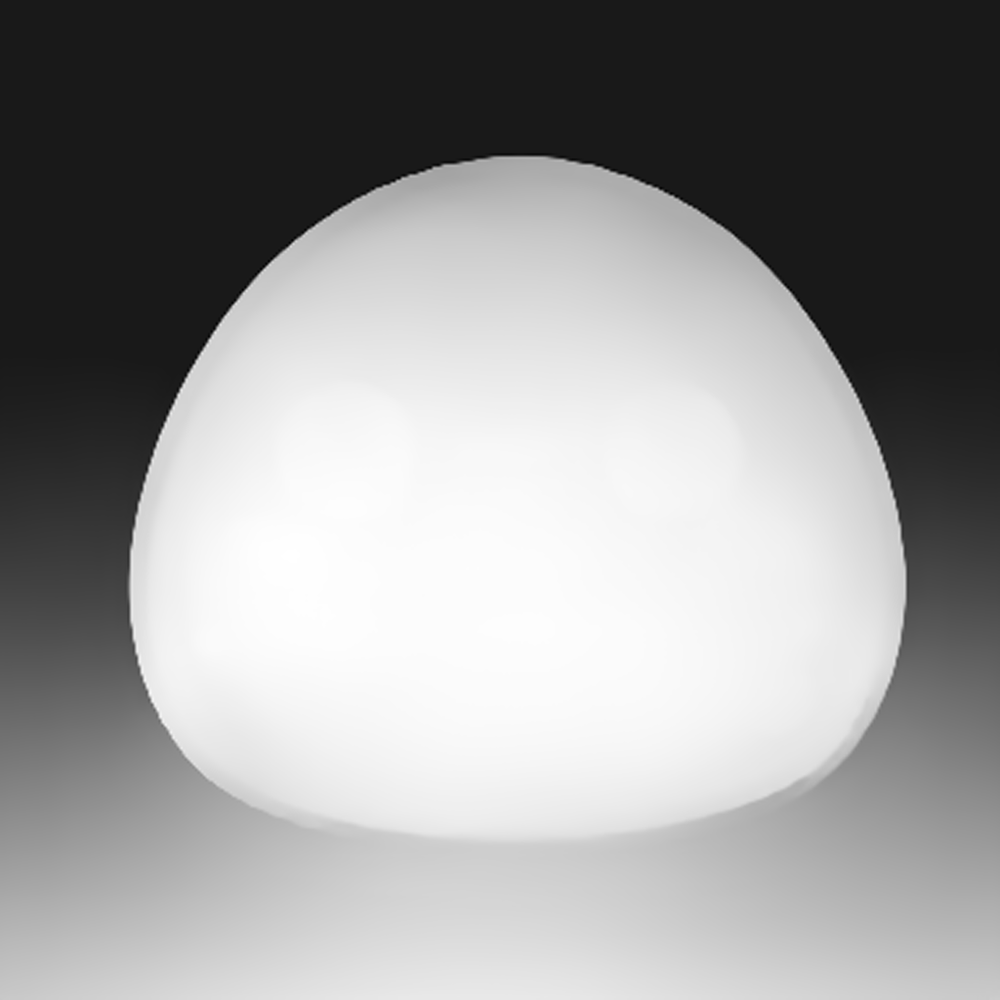
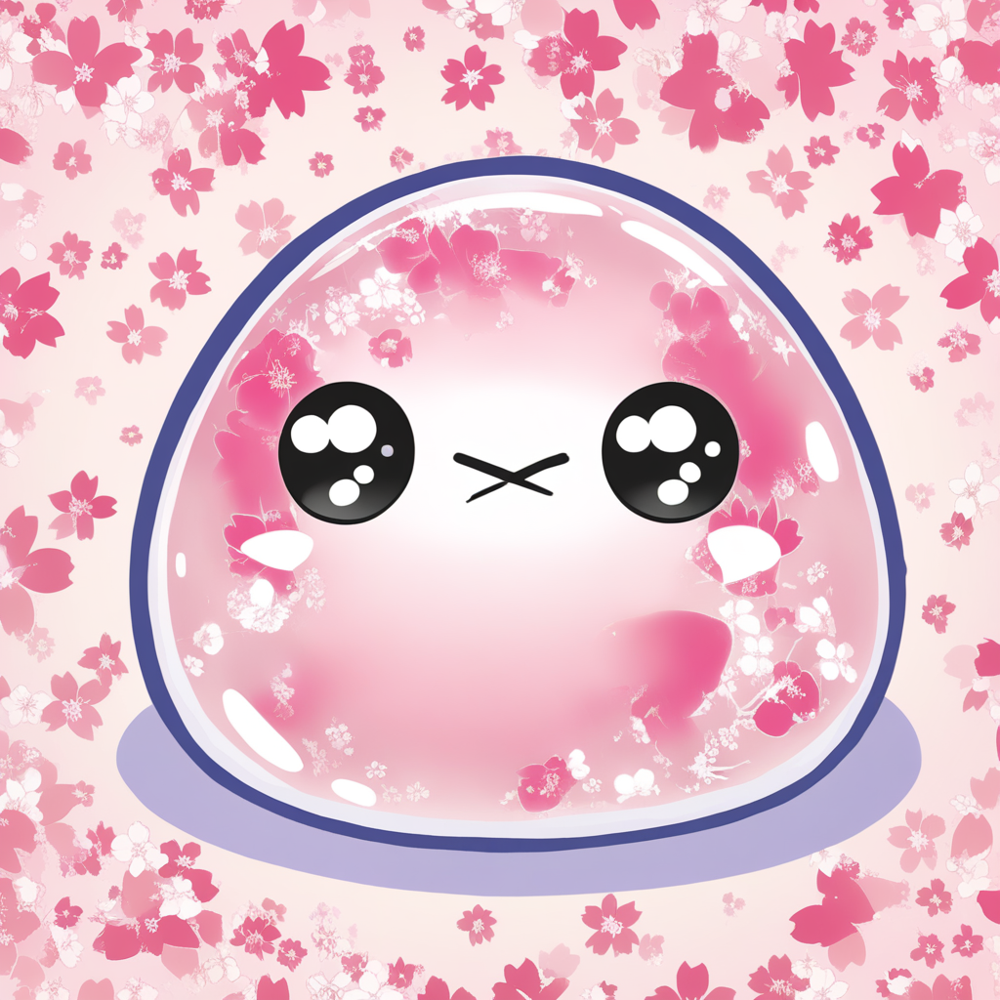
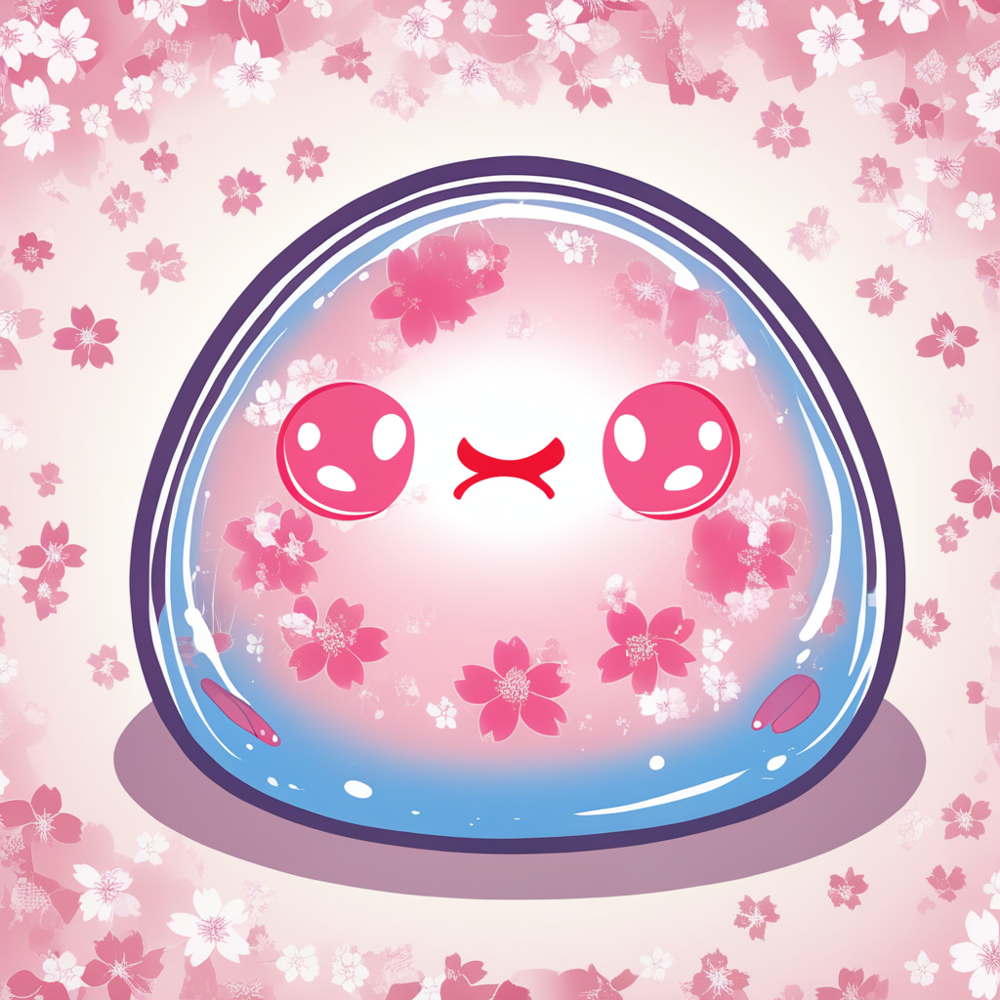
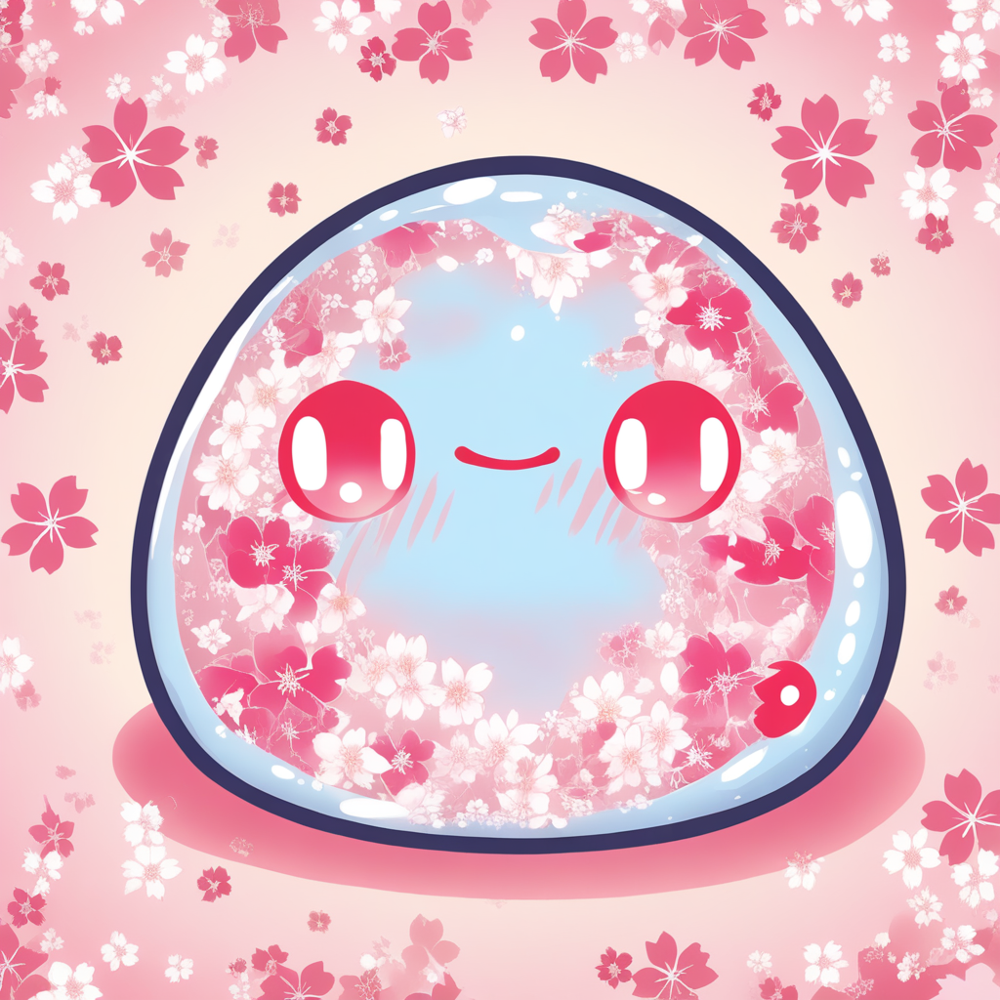

In [6]:
# run ControlNet depth with StyleAligned

reference_prompt = "effect with cherry blossom pattern"
target_prompts = ["a sword of effect with cherry blossom pattern", "a slime of effect with cherry blossom pattern"]
controlnet_conditioning_scale = 0.8
num_images_per_prompt = 3 # adjust according to VRAM size
latents = torch.randn(1 + num_images_per_prompt, 4, 128, 128).to(pipeline.unet.dtype)

for deph_map, target_prompt in zip((depth_image1, depth_image2), target_prompts):
    latents[1:] = torch.randn(num_images_per_prompt, 4, 128, 128).to(pipeline.unet.dtype)

    images = pipeline_calls.controlnet_call(pipeline, [reference_prompt, target_prompt],
                                            image=deph_map,
                                            num_inference_steps=50,
                                            controlnet_conditioning_scale=controlnet_conditioning_scale,
                                            num_images_per_prompt=num_images_per_prompt,
                                           latents=latents)
    
    mediapy.show_images([images[0], deph_map] +  images[1:], titles=["reference", "depth"] + [f'result {i}' for i in range(1, len(images))])


In [7]:
# VRAM=13.9GB